In [1]:
#Single Encoder
#BottleNeck: 8

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[8], [10], [12], [14], [16], [18] ,[20]]
decoder_dense_layers_trial = [[8, 10], [10, 12], [12, 14], [14, 16], [16, 18], [18, 20], [20,22]]
bottle_neck_trial = [8]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[8] 8 [8, 10]
[8] 8 [10, 12]
[8] 8 [12, 14]
[8] 8 [14, 16]
[8] 8 [16, 18]
[8] 8 [18, 20]
[8] 8 [20, 22]
[10] 8 [8, 10]
[10] 8 [10, 12]
[10] 8 [12, 14]
[10] 8 [14, 16]
[10] 8 [16, 18]
[10] 8 [18, 20]
[10] 8 [20, 22]
[12] 8 [8, 10]
[12] 8 [10, 12]
[12] 8 [12, 14]
[12] 8 [14, 16]
[12] 8 [16, 18]
[12] 8 [18, 20]
[12] 8 [20, 22]
[14] 8 [8, 10]
[14] 8 [10, 12]
[14] 8 [12, 14]
[14] 8 [14, 16]
[14] 8 [16, 18]
[14] 8 [18, 20]
[14] 8 [20, 22]
[16] 8 [8, 10]
[16] 8 [10, 12]
[16] 8 [12, 14]
[16] 8 [14, 16]
[16] 8 [16, 18]
[16] 8 [18, 20]
[16] 8 [20, 22]
[18] 8 [8, 10]
[18] 8 [10, 12]
[18] 8 [12, 14]
[18] 8 [14, 16]
[18] 8 [16, 18]
[18] 8 [18, 20]
[18] 8 [20, 22]
[20] 8 [8, 10]
[20] 8 [10, 12]
[20] 8 [12, 14]
[20] 8 [14, 16]
[20] 8 [16, 18]
[20] 8 [18, 20]
[20] 8 [20, 22]


[8] 8 [8, 10]
[8] 8 [8, 10]

L24_E8_B8_D8_10

Training model: L24_E8_B8_D8_10
Training Complete:
Last epoch loss: 0.020200546830892563
Last epoch validation loss: 0.028830567374825478
Reports Saved
[8] 8 [10, 12]
[8] 8 [10, 12]

L24_E8_B8_D10_12

Training model: L24_E8_B8_D10_12
Training Complete:
Last epoch loss: 0.011874248273670673
Last epoch validation loss: 0.01939627155661583
Reports Saved
[8] 8 [12, 14]
[8] 8 [12, 14]

L24_E8_B8_D12_14

Training model: L24_E8_B8_D12_14
Training Complete:
Last epoch loss: 0.012531859800219536
Last epoch validation loss: 0.019103098660707474
Reports Saved
[8] 8 [14, 16]
[8] 8 [14, 16]

L24_E8_B8_D14_16

Training model: L24_E8_B8_D14_16
Training Complete:
Last epoch loss: 0.012236549519002438
Last epoch validation loss: 0.019295712932944298
Reports Saved
[8] 8 [16, 18]
[8] 8 [16, 18]

L24_E8_B8_D16_18

Training model: L24_E8_B8_D16_18
Training Complete:
Last epoch loss: 0.012113389559090137
Last epoch validation loss: 0.01837715320289135
Reports Sa

Reports Saved
[10] 8 [18, 20]
[10] 8 [18, 20]

L24_E10_B8_D18_20

Training model: L24_E10_B8_D18_20
Training Complete:
Last epoch loss: 0.011965060606598854
Last epoch validation loss: 0.01828710362315178
Reports Saved
[10] 8 [20, 22]
[10] 8 [20, 22]

L24_E10_B8_D20_22

Training model: L24_E10_B8_D20_22
Training Complete:
Last epoch loss: 0.01187532301992178
Last epoch validation loss: 0.018307331949472427
Reports Saved
[12] 8 [8, 10]
[12] 8 [8, 10]

L24_E12_B8_D8_10

Training model: L24_E12_B8_D8_10
Training Complete:
Last epoch loss: 0.013718691654503345
Last epoch validation loss: 0.02140418253839016
Reports Saved
[12] 8 [10, 12]
[12] 8 [10, 12]

L24_E12_B8_D10_12

Training model: L24_E12_B8_D10_12
Training Complete:
Last epoch loss: 0.01226954534649849
Last epoch validation loss: 0.017864858731627464
Reports Saved
[12] 8 [12, 14]
[12] 8 [12, 14]

L24_E12_B8_D12_14

Training model: L24_E12_B8_D12_14
Training Complete:
Last epoch loss: 0.00901880208402872
Last epoch validation loss: 

Reports Saved
[14] 8 [8, 10]
[14] 8 [8, 10]

L24_E14_B8_D8_10

Training model: L24_E14_B8_D8_10
Training Complete:
Last epoch loss: 0.012476848438382149
Last epoch validation loss: 0.020905442535877228
Reports Saved
[14] 8 [10, 12]
[14] 8 [10, 12]

L24_E14_B8_D10_12

Training model: L24_E14_B8_D10_12
Training Complete:
Last epoch loss: 0.012231040745973587
Last epoch validation loss: 0.01814848557114601
Reports Saved
[14] 8 [12, 14]
[14] 8 [12, 14]

L24_E14_B8_D12_14

Training model: L24_E14_B8_D12_14
Training Complete:
Last epoch loss: 0.012664824724197388
Last epoch validation loss: 0.019880473613739014
Reports Saved
[14] 8 [14, 16]
[14] 8 [14, 16]

L24_E14_B8_D14_16

Training model: L24_E14_B8_D14_16
Training Complete:
Last epoch loss: 0.012472902424633503
Last epoch validation loss: 0.01951715536415577
Reports Saved
[14] 8 [16, 18]
[14] 8 [16, 18]

L24_E14_B8_D16_18

Training model: L24_E14_B8_D16_18
Training Complete:
Last epoch loss: 0.012170908972620964
Last epoch validation los

Reports Saved
[16] 8 [12, 14]
[16] 8 [12, 14]

L24_E16_B8_D12_14

Training model: L24_E16_B8_D12_14
Training Complete:
Last epoch loss: 0.009399677626788616
Last epoch validation loss: 0.016716692596673965
Reports Saved
[16] 8 [14, 16]
[16] 8 [14, 16]

L24_E16_B8_D14_16

Training model: L24_E16_B8_D14_16
Training Complete:
Last epoch loss: 0.011148874647915363
Last epoch validation loss: 0.015808148309588432
Reports Saved
[16] 8 [16, 18]
[16] 8 [16, 18]

L24_E16_B8_D16_18

Training model: L24_E16_B8_D16_18
Training Complete:
Last epoch loss: 0.012288657948374748
Last epoch validation loss: 0.018581179901957512
Reports Saved
[16] 8 [18, 20]
[16] 8 [18, 20]

L24_E16_B8_D18_20

Training model: L24_E16_B8_D18_20
Training Complete:
Last epoch loss: 0.009127181023359299
Last epoch validation loss: 0.014884736388921738
Reports Saved
[16] 8 [20, 22]
[16] 8 [20, 22]

L24_E16_B8_D20_22

Training model: L24_E16_B8_D20_22
Training Complete:
Last epoch loss: 0.007531493902206421
Last epoch validati

Reports Saved
[18] 8 [16, 18]
[18] 8 [16, 18]

L24_E18_B8_D16_18

Training model: L24_E18_B8_D16_18
Training Complete:
Last epoch loss: 0.010803992860019207
Last epoch validation loss: 0.017130816355347633
Reports Saved
[18] 8 [18, 20]
[18] 8 [18, 20]

L24_E18_B8_D18_20

Training model: L24_E18_B8_D18_20
Training Complete:
Last epoch loss: 0.007940353825688362
Last epoch validation loss: 0.012923505157232285
Reports Saved
[18] 8 [20, 22]
[18] 8 [20, 22]

L24_E18_B8_D20_22

Training model: L24_E18_B8_D20_22
Training Complete:
Last epoch loss: 0.011614744551479816
Last epoch validation loss: 0.016876455396413803
Reports Saved
[20] 8 [8, 10]
[20] 8 [8, 10]

L24_E20_B8_D8_10

Training model: L24_E20_B8_D8_10
Training Complete:
Last epoch loss: 0.012028329074382782
Last epoch validation loss: 0.018264876678586006
Reports Saved
[20] 8 [10, 12]
[20] 8 [10, 12]

L24_E20_B8_D10_12

Training model: L24_E20_B8_D10_12
Training Complete:
Last epoch loss: 0.00980702880769968
Last epoch validation lo

Reports Saved
[20] 8 [20, 22]
[20] 8 [20, 22]

L24_E20_B8_D20_22

Training model: L24_E20_B8_D20_22
Training Complete:
Last epoch loss: 0.008082045242190361
Last epoch validation loss: 0.013844688422977924
Reports Saved
Total time: 48.03494946161906 minutes


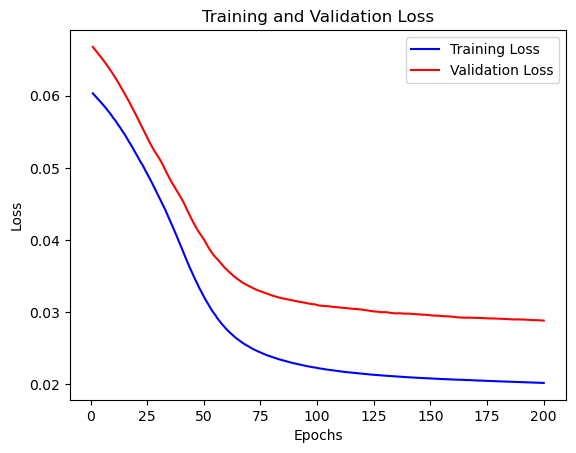

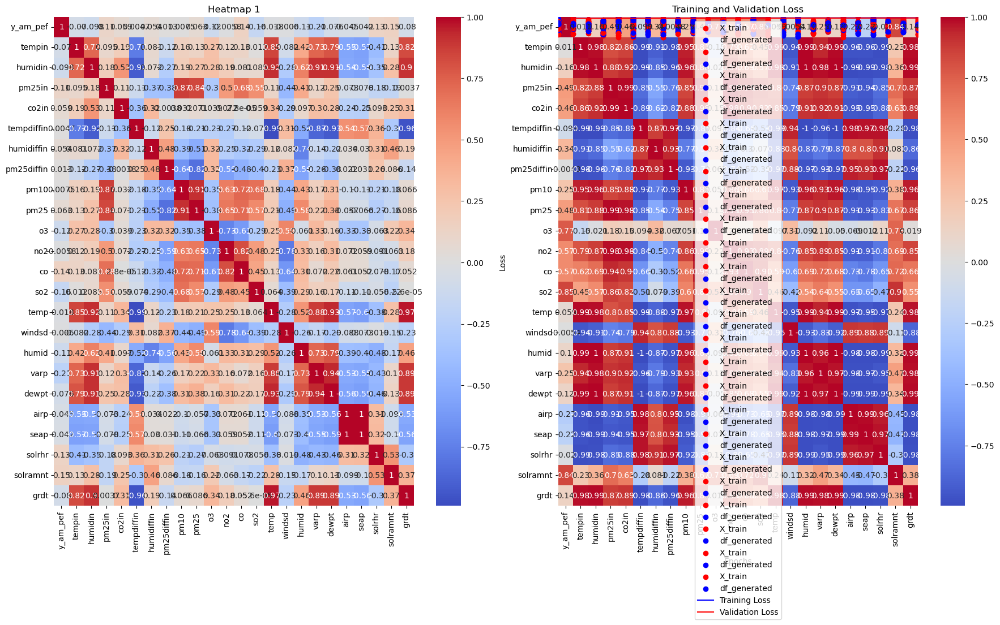

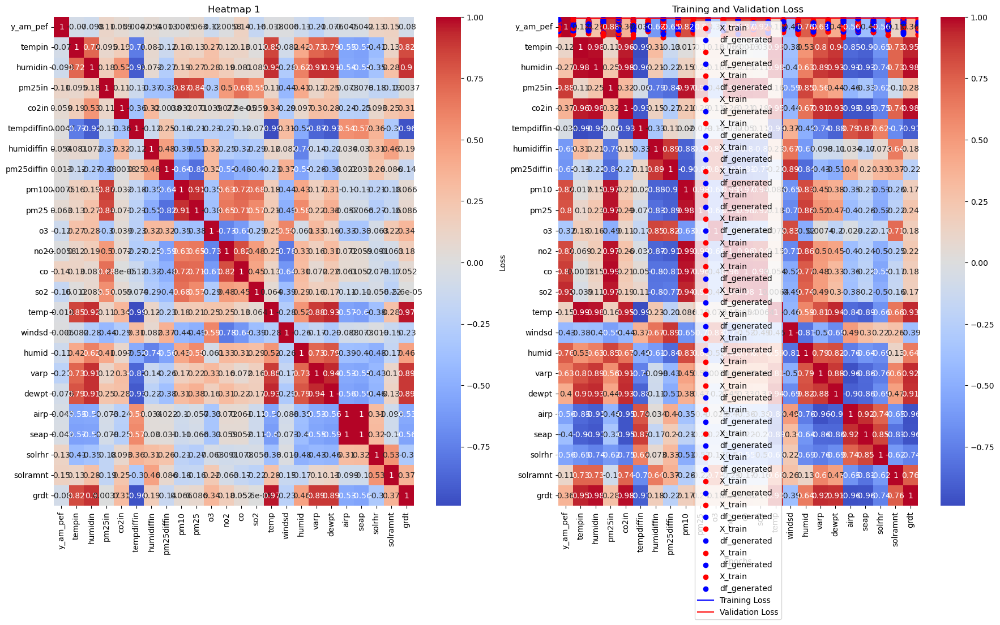

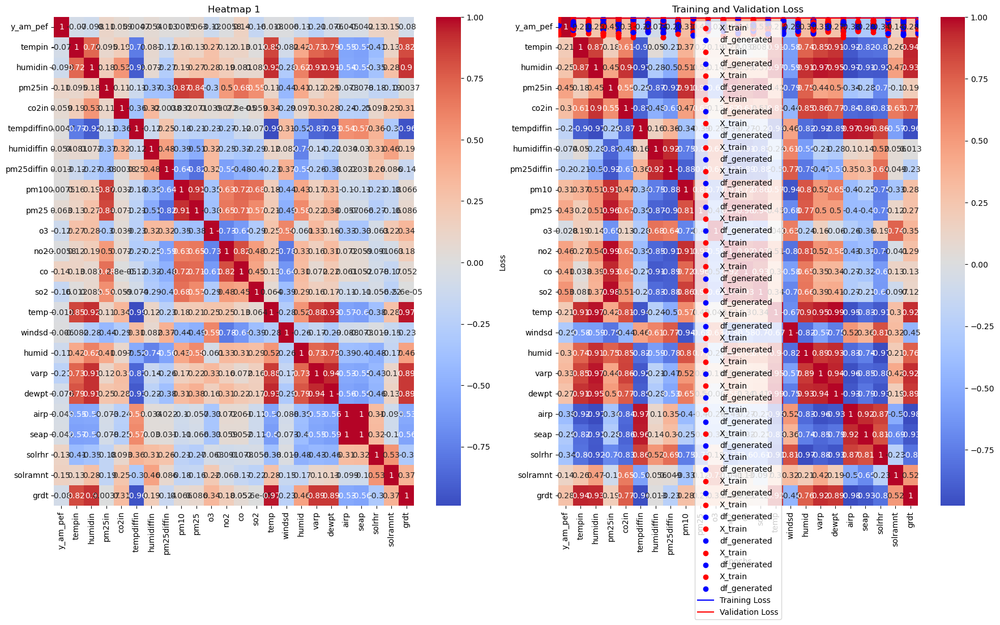

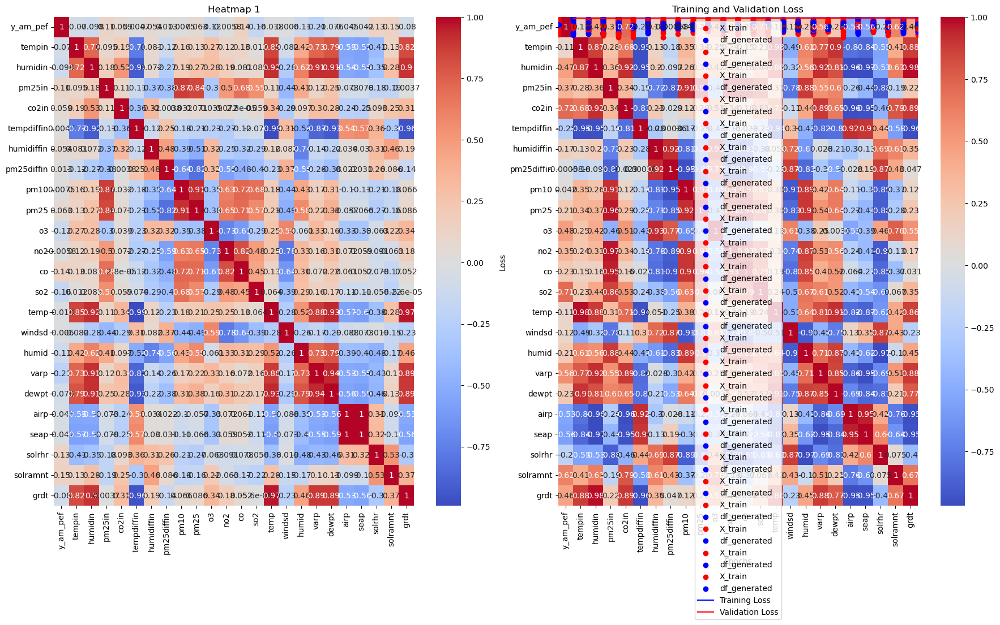

...

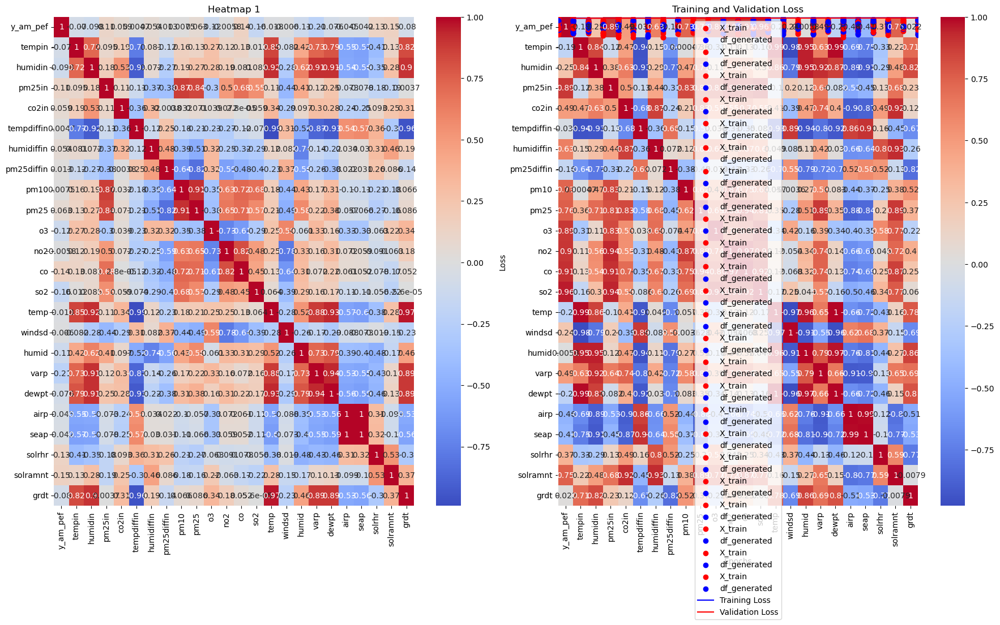

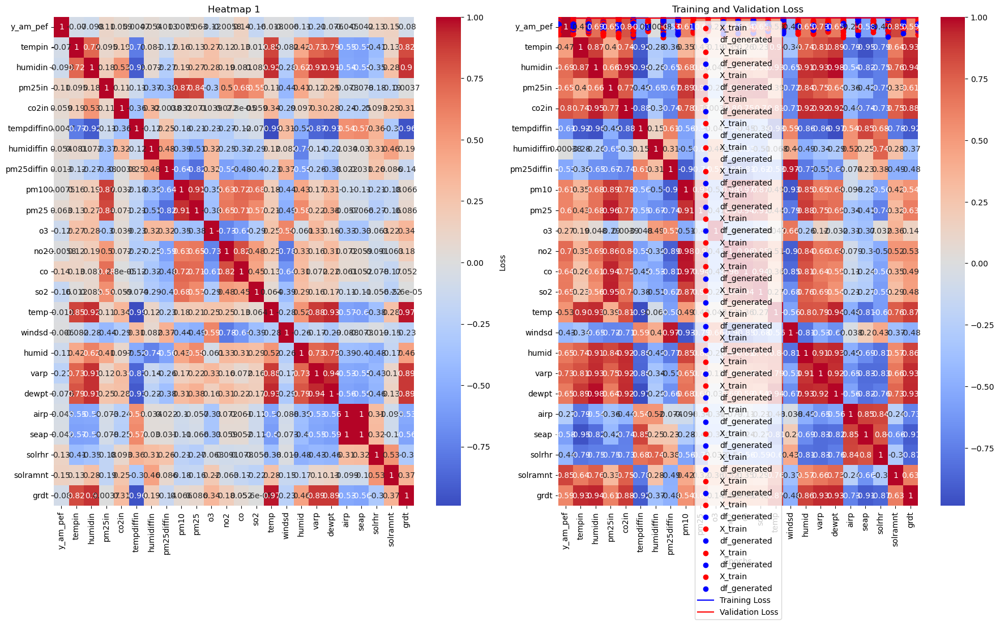

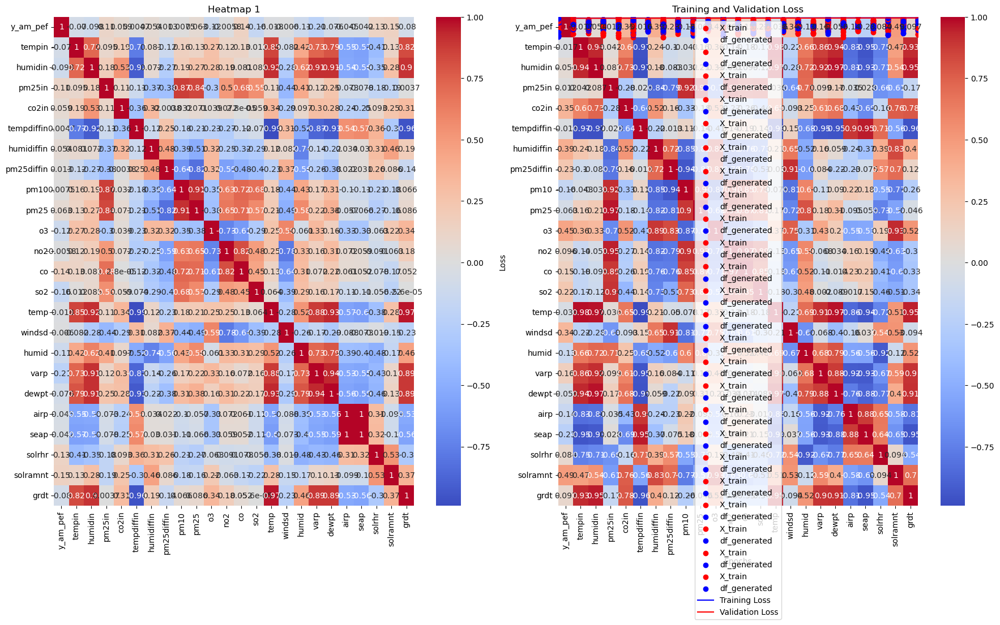

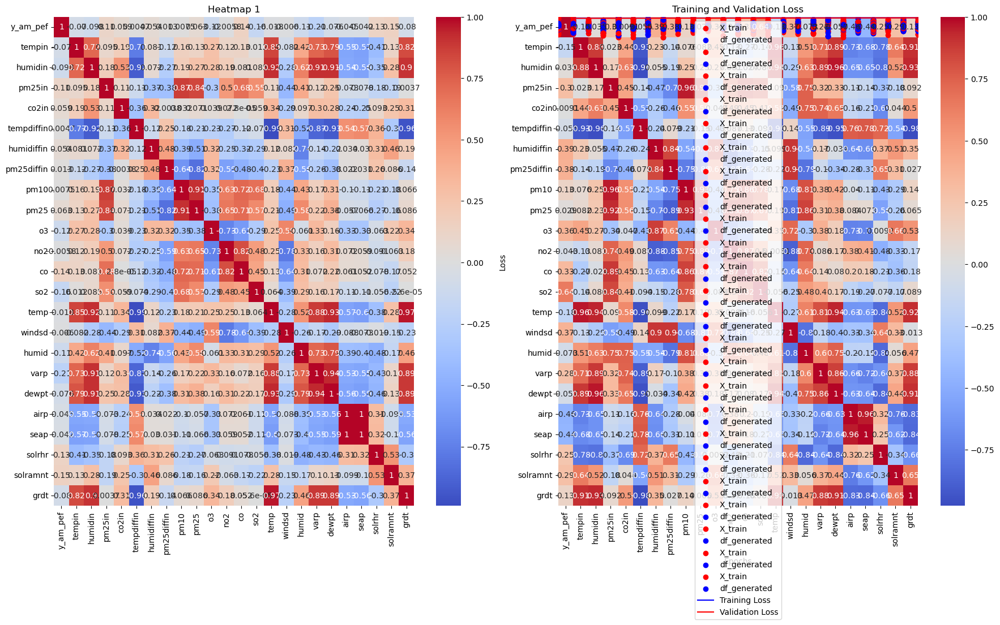

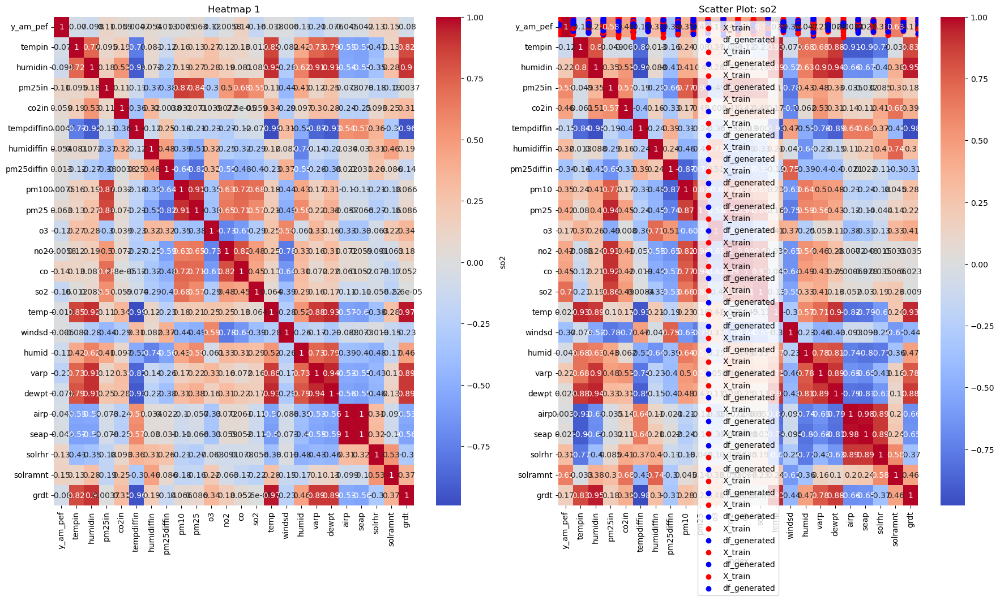

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [13]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E18_B8_D10_12', 0.02023199014365673, 0.028943633660674095]
['L24_E8_B8_D8_10', 0.020200546830892563, 0.028830567374825478]
['L24_E20_B8_D12_14', 0.016898827627301216, 0.02436675690114498]
['L24_E18_B8_D8_10', 0.015578200109302998, 0.025060810148715973]
['L24_E16_B8_D8_10', 0.014301004819571972, 0.0209703017026186]
['L24_E12_B8_D8_10', 0.013718691654503345, 0.02140418253839016]
['L24_E8_B8_D18_20', 0.013265992514789104, 0.020994611084461212]
['L24_E10_B8_D8_10', 0.012718142941594124, 0.019321104511618614]
['L24_E14_B8_D12_14', 0.012664824724197388, 0.019880473613739014]
['L24_E8_B8_D12_14', 0.012531859800219536, 0.019103098660707474]


In [14]:
for item in run_summary:
    print(item)

['L24_E18_B8_D10_12', 0.02023199014365673, 0.028943633660674095]
['L24_E8_B8_D8_10', 0.020200546830892563, 0.028830567374825478]
['L24_E20_B8_D12_14', 0.016898827627301216, 0.02436675690114498]
['L24_E18_B8_D8_10', 0.015578200109302998, 0.025060810148715973]
['L24_E16_B8_D8_10', 0.014301004819571972, 0.0209703017026186]
['L24_E12_B8_D8_10', 0.013718691654503345, 0.02140418253839016]
['L24_E8_B8_D18_20', 0.013265992514789104, 0.020994611084461212]
['L24_E10_B8_D8_10', 0.012718142941594124, 0.019321104511618614]
['L24_E14_B8_D12_14', 0.012664824724197388, 0.019880473613739014]
['L24_E8_B8_D12_14', 0.012531859800219536, 0.019103098660707474]
['L24_E14_B8_D8_10', 0.012476848438382149, 0.020905442535877228]
['L24_E14_B8_D14_16', 0.012472902424633503, 0.01951715536415577]
['L24_E16_B8_D16_18', 0.012288657948374748, 0.018581179901957512]
['L24_E12_B8_D10_12', 0.01226954534649849, 0.017864858731627464]
['L24_E8_B8_D14_16', 0.012236549519002438, 0.019295712932944298]
['L24_E14_B8_D10_12', 0.012